In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from plotly import __version__
import plotly.express as px


In [2]:
suicides_rates_data = pd.read_csv("master.csv")

In [3]:
suicides_rates_data.head()

,country,year,sex,age,suicides_no,population,suicides/100k pop,country-year,HDI for year,gdp_for_year ($),gdp_per_capita ($),generation
0,Albania,1987,male,15-24 years,21.0,312900,6.71,Albania1987,NaN,"2,15,66,24,900",796.0,Generation X
1,Albania,1987,male,35-54 years,16.0,308000,5.19,Albania1987,NaN,"2,15,66,24,900",796.0,Silent
2,Albania,1987,female,15-24 years,14.0,289700,4.83,Albania1987,NaN,"2,15,66,24,900",796.0,Generation X
3,Albania,1987,male,75+ years,1.0,21800,4.59,Albania1987,NaN,"2,15,66,24,900",796.0,G.I. Generation
4,Albania,1987,male,25-34 years,9.0,274300,3.28,Albania1987,NaN,"2,15,66,24,900",796.0,Boomers


#####  here we have renamed all the feature for the convenience 

In [4]:
suicides_rates_data.columns = ['country', 'year', 'gender', 'age_group', 'suicide_count', 
                'population', 'suicide_rate', 'country-year', 'HDI for year',
                'gdp_for_year', 'gdp_per_capita', 'generation']
suicides_rates_data.columns

Index(['country', 'year', 'gender', 'age_group', 'suicide_count', 'population',
       'suicide_rate', 'country-year', 'HDI for year', 'gdp_for_year',
       'gdp_per_capita', 'generation'],
      dtype='object')

In [5]:
suicides_rates_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31756 entries, 0 to 31755
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   country         31756 non-null  object 
 1   year            31756 non-null  int64  
 2   gender          31756 non-null  object 
 3   age_group       31756 non-null  object 
 4   suicide_count   30556 non-null  float64
 5   population      31756 non-null  int64  
 6   suicide_rate    31756 non-null  float64
 7   country-year    31756 non-null  object 
 8   HDI for year    12300 non-null  float64
 9   gdp_for_year    31756 non-null  object 
 10  gdp_per_capita  31756 non-null  float64
 11  generation      31756 non-null  object 
dtypes: float64(4), int64(2), object(6)
memory usage: 2.9+ MB


#####  as we can see above gdp_for_year is in object type, so here, we are converting gdp_for_year column from object to float 

In [6]:
#converting string to object
suicides_rates_data['gdp_for_year'] = suicides_rates_data['gdp_for_year'].str.replace(',','').astype(float)

In [7]:
suicides_rates_data.describe()

,year,suicide_count,population,suicide_rate,HDI for year,gdp_for_year,gdp_per_capita
count,31756.000000,30556.000000,3.175600e+04,31756.000000,12300.000000,3.175600e+04,31756.000000
mean,2003.395390,237.136242,7.217454e+06,11.716668,0.793666,5.722487e+11,17588.954606
std,9.760604,867.956107,5.799323e+07,21.590926,0.097480,2.544261e+12,19464.861140
min,1985.000000,0.000000,2.780000e+02,0.000000,0.377790,4.691962e+07,251.000000
25%,1996.000000,3.000000,1.288210e+05,0.370000,0.727000,1.055334e+10,3765.000000
50%,2004.000000,25.000000,5.468325e+05,4.285000,0.800457,5.584969e+10,10062.000000
75%,2011.000000,132.000000,2.908763e+06,14.560000,0.874000,2.865191e+11,25622.000000
max,2020.000000,22338.000000,1.411100e+09,515.092734,0.975114,5.100000e+13,126352.000000


In [8]:
suicides_rates_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31756 entries, 0 to 31755
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   country         31756 non-null  object 
 1   year            31756 non-null  int64  
 2   gender          31756 non-null  object 
 3   age_group       31756 non-null  object 
 4   suicide_count   30556 non-null  float64
 5   population      31756 non-null  int64  
 6   suicide_rate    31756 non-null  float64
 7   country-year    31756 non-null  object 
 8   HDI for year    12300 non-null  float64
 9   gdp_for_year    31756 non-null  float64
 10  gdp_per_capita  31756 non-null  float64
 11  generation      31756 non-null  object 
dtypes: float64(5), int64(2), object(5)
memory usage: 2.9+ MB


#####  In the below cell we are checking for any null value in our dataset using plotly libraries, as we can see in th below graph there approx 20k null values in HDI_for Year and  1500 null values in suicide_count

In [9]:
#checking for null values
px.bar(suicides_rates_data.isnull().sum())

#####  To remove all the null value from suicide_count we have used the Imputation technique of mean on suicide_count whereas for HDI_for_year, we have drop that column as its had too many null values. Futrthermore, there was another unwanted feature named country_year which was giving the same information as country and year feature. so, we also removing the country_year feature 

In [10]:
#handling null values
from sklearn.impute import SimpleImputer

In [11]:
imputer = SimpleImputer(missing_values=np.nan, strategy='mean')
imputer.fit(suicides_rates_data[["suicide_count"]])
suicides_rates_data['suicide_count'] = imputer.transform(suicides_rates_data[['suicide_count']])

In [12]:
suicides_rates_data.drop("HDI for year",axis=1,inplace=True)

In [13]:
suicides_rates_data.isnull().sum()

country           0
year              0
gender            0
age_group         0
suicide_count     0
population        0
suicide_rate      0
country-year      0
gdp_for_year      0
gdp_per_capita    0
generation        0
dtype: int64

In [14]:
#removing unwanted columns
suicides_rates_data.drop(["country-year"],axis=1,inplace=True)

In [15]:
suicides_rates_data.head(5)

,country,year,gender,age_group,suicide_count,population,suicide_rate,gdp_for_year,gdp_per_capita,generation
0,Albania,1987,male,15-24 years,21.0,312900,6.71,2.156625e+09,796.0,Generation X
1,Albania,1987,male,35-54 years,16.0,308000,5.19,2.156625e+09,796.0,Silent
2,Albania,1987,female,15-24 years,14.0,289700,4.83,2.156625e+09,796.0,Generation X
3,Albania,1987,male,75+ years,1.0,21800,4.59,2.156625e+09,796.0,G.I. Generation
4,Albania,1987,male,25-34 years,9.0,274300,3.28,2.156625e+09,796.0,Boomers


In [16]:
px.imshow(suicides_rates_data.corr(),text_auto=True, aspect="auto")

C:\Users\dhrup\AppData\Local\Temp\ipykernel_16604\314768611.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



##### This is the lmplot scatter plot which shows the relation between gbp_per_capita and year. as we can see that gdp_per_capita is taking upword trend  with years

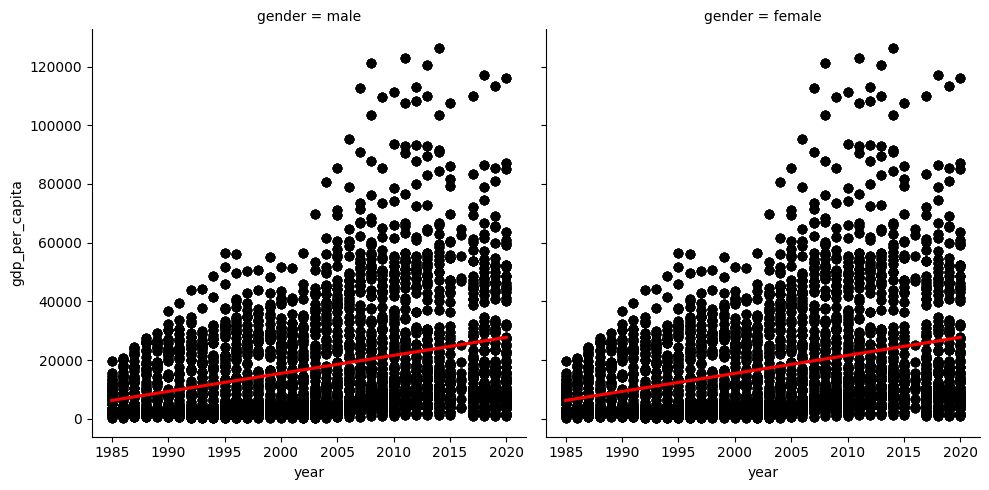

In [17]:
sns.lmplot(suicides_rates_data,x="year",y="gdp_per_capita",
           col="gender",scatter_kws={"color": "black"}, line_kws={"color": "red"})

#####  The below histogram describes the suicides_count according to the country and gender as we can see that Russian federation takes top place in the count of suicide followed by united states in second and japan in third place

In [18]:
px.histogram(suicides_rates_data,x="country",y="suicide_count",color="gender",height=1000,width=1000)

#####  The below histogram describes the suicides_count according to the age-group and gender where as most of the people who commited suicide were from between 35-54 years in both genders 

In [19]:
px.histogram(suicides_rates_data, x="age_group", y="suicide_count", color="gender", facet_col="gender")

##### Here scatter_3d plot describe bunch of information regarding to the trends of gdp_per_capita and suicide_count according to the years,country and generation. as we can the see, when gdp_per_capita take the upword trends with years whereas suicide_count started with its lowest point and rose toward its peak from 1995 to 2005 and then started showing downfall in suicide count

In [20]:
px.scatter_3d(suicides_rates_data, x='gdp_per_capita', y='suicide_count', z='year',
              color='country', size="gdp_per_capita", size_max=20,
              symbol='generation', opacity=0.7)

##### The lineplot below shows the trend of polulation in the accordance of years

<AxesSubplot: xlabel='year', ylabel='population'>

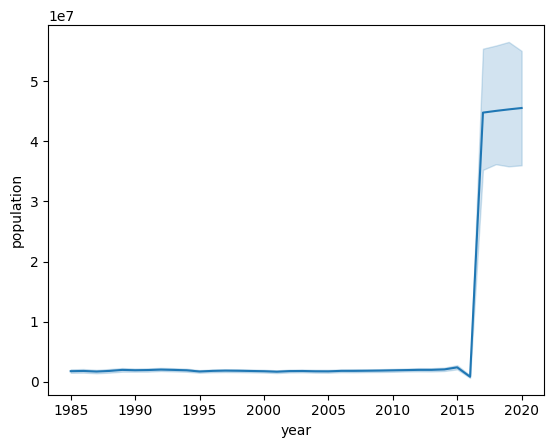

In [21]:
sns.lineplot(data=suicides_rates_data,x="year",y="population")

#####  the piechart gives the information of suicide rates according to generations as its clear from picture that most of the suicide count are from boomer generation and least are from Generation z

In [22]:
px.pie(suicides_rates_data, values='suicide_count',names="generation")

##### In this part of the code we have converted some values in coutry column as accordance to the Pycountry_converter package. the reason behind coverting the values is to create new feature called continent. so that we can analysis data according to the continent and the second is, that is would have easier to used enocoding method on continent as compare to country

In [23]:
#replacing some values according to Pycountry_converter
suicides_rates_data['country'] = suicides_rates_data['country'].str.replace('Republic of Korea','South Korea')
suicides_rates_data['country'] = suicides_rates_data['country'].str.replace('Saint Vincent and Grenadines','Saint Vincent and the Grenadines')
suicides_rates_data['country'] = suicides_rates_data['country'].str.replace('China, Hong Kong SAR','China')
suicides_rates_data["country"].unique()

array(['Albania', 'Antigua and Barbuda', 'Argentina', 'Armenia', 'Aruba',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Barbados', 'Belarus', 'Belgium', 'Belize',
       'Bosnia and Herzegovina', 'Brazil', 'Bulgaria', 'Cabo Verde',
       'Canada', 'Chile', 'Colombia', 'Costa Rica', 'Croatia', 'Cuba',
       'Cyprus', 'Czech Republic', 'Denmark', 'Dominica', 'Ecuador',
       'El Salvador', 'Estonia', 'Fiji', 'Finland', 'France', 'Georgia',
       'Germany', 'Greece', 'Grenada', 'Guatemala', 'Guyana', 'Hungary',
       'Iceland', 'Ireland', 'Israel', 'Italy', 'Jamaica', 'Japan',
       'Kazakhstan', 'Kiribati', 'Kuwait', 'Kyrgyzstan', 'Latvia',
       'Lithuania', 'Luxembourg', 'Macau', 'Maldives', 'Malta',
       'Mauritius', 'Mexico', 'Mongolia', 'Montenegro', 'Netherlands',
       'New Zealand', 'Nicaragua', 'Norway', 'Oman', 'Panama', 'Paraguay',
       'Philippines', 'Poland', 'Portugal', 'Puerto Rico', 'Qatar',
       'South Korea', 'Romania', 'Russia

In [24]:
import pycountry_convert as pc

def country_to_continent(country_name):
    country_alpha2 = pc.country_name_to_country_alpha2(country_name)
    country_continent_code = pc.country_alpha2_to_continent_code(country_alpha2)
    country_continent_name = pc.convert_continent_code_to_continent_name(country_continent_code)
    return country_continent_name

In [25]:
#creating new column with continent
suicides_rates_data["Continent"] =suicides_rates_data["country"].apply(country_to_continent)

In [26]:
suicides_rates_data["Continent"].unique()

array(['Europe', 'North America', 'South America', 'Asia', 'Oceania',
       'Africa'], dtype=object)

In [27]:
suicides_rates_data.head()

,country,year,gender,age_group,suicide_count,population,suicide_rate,gdp_for_year,gdp_per_capita,generation,Continent
0,Albania,1987,male,15-24 years,21.0,312900,6.71,2.156625e+09,796.0,Generation X,Europe
1,Albania,1987,male,35-54 years,16.0,308000,5.19,2.156625e+09,796.0,Silent,Europe
2,Albania,1987,female,15-24 years,14.0,289700,4.83,2.156625e+09,796.0,Generation X,Europe
3,Albania,1987,male,75+ years,1.0,21800,4.59,2.156625e+09,796.0,G.I. Generation,Europe
4,Albania,1987,male,25-34 years,9.0,274300,3.28,2.156625e+09,796.0,Boomers,Europe


#####  The two pychart below compares the suicide_count of male and female according to the continent

In [28]:
px.pie(suicides_rates_data, values='suicide_count',names="Continent",facet_col="gender")

##### The scatter plot below describes the information of sucide_count over the years and according to continent,population and country

In [29]:
px.scatter(suicides_rates_data, x = 'year', y='suicide_count', 
                 log_x = True, hover_name = 'country', color = 'Continent', size = 'population',size_max=60)

 ##### the graph below compares the suicide count according the generation and continent where europe has most of the sucide and africa is least

In [30]:
px.histogram(suicides_rates_data,x="Continent",y="suicide_count",color="generation",barmode="group")

##### In this part of the code we are converting the catogorical data to numerical. for that we have removed the country feature from our dataset  and used one hot encoding on generation and continent  whereas labelencoding on gender and age_group and create seperate dataframe from categorical features 

In [31]:
#removing unwanted column
suicides_rates_data.drop("country",axis=1,inplace=True)

In [32]:
#converting categorical values using one hot encoding
list_of_Categorical_col = ['generation','Continent' ]
categorical_data = pd.get_dummies(suicides_rates_data[list_of_Categorical_col])

In [33]:
#converting categorical values using Label Encoding 
from sklearn.preprocessing import LabelEncoder


le=LabelEncoder()
gender = pd.DataFrame(le.fit_transform(suicides_rates_data["gender"]))
gender.columns = ["gender"]
age_group = pd.DataFrame(le.fit_transform(suicides_rates_data["age_group"]))
age_group.columns = ["age_group"]

categorical_data2 = pd.concat([gender,age_group],axis=1)
categorical_data = pd.concat([categorical_data,categorical_data2],axis=1)
categorical_data.head()


,generation_Boomers,generation_G.I. Generation,generation_Generation X,generation_Generation Z,generation_Millenials,generation_Silent,Continent_Africa,Continent_Asia,Continent_Europe,Continent_North America,Continent_Oceania,Continent_South America,gender,age_group
0,0,0,1,0,0,0,0,0,1,0,0,0,1,0
1,0,0,0,0,0,1,0,0,1,0,0,0,1,2
2,0,0,1,0,0,0,0,0,1,0,0,0,0,0
3,0,1,0,0,0,0,0,0,1,0,0,0,1,5
4,1,0,0,0,0,0,0,0,1,0,0,0,1,1


##### Here we have extracted all the numberical data from original dataset and preformed stander scalar techque to scale the data 

In [34]:
#creating new dataset of only numberic data
list_of_numerical_col = [ 'suicide_count', 'population','suicide_rate', 'gdp_for_year', 'gdp_per_capita']
numeric_data = suicides_rates_data[list_of_numerical_col].copy()

In [35]:
numeric_data.columns

Index(['suicide_count', 'population', 'suicide_rate', 'gdp_for_year',
       'gdp_per_capita'],
      dtype='object')

In [36]:
#scaling the numberic data
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(numeric_data)
scaled_data = scaler.transform(numeric_data)
scaled_numeric_data = pd.DataFrame(scaled_data)


In [37]:
scaled_numeric_data.columns = ['suicide_count', 'population', 'suicide_rate', 'gdp_for_year','gdp_per_capita']

##### here we have passed only scaled_ numeric data to pairplot to see where our data lies as we can see the most of our data is skewed to left side

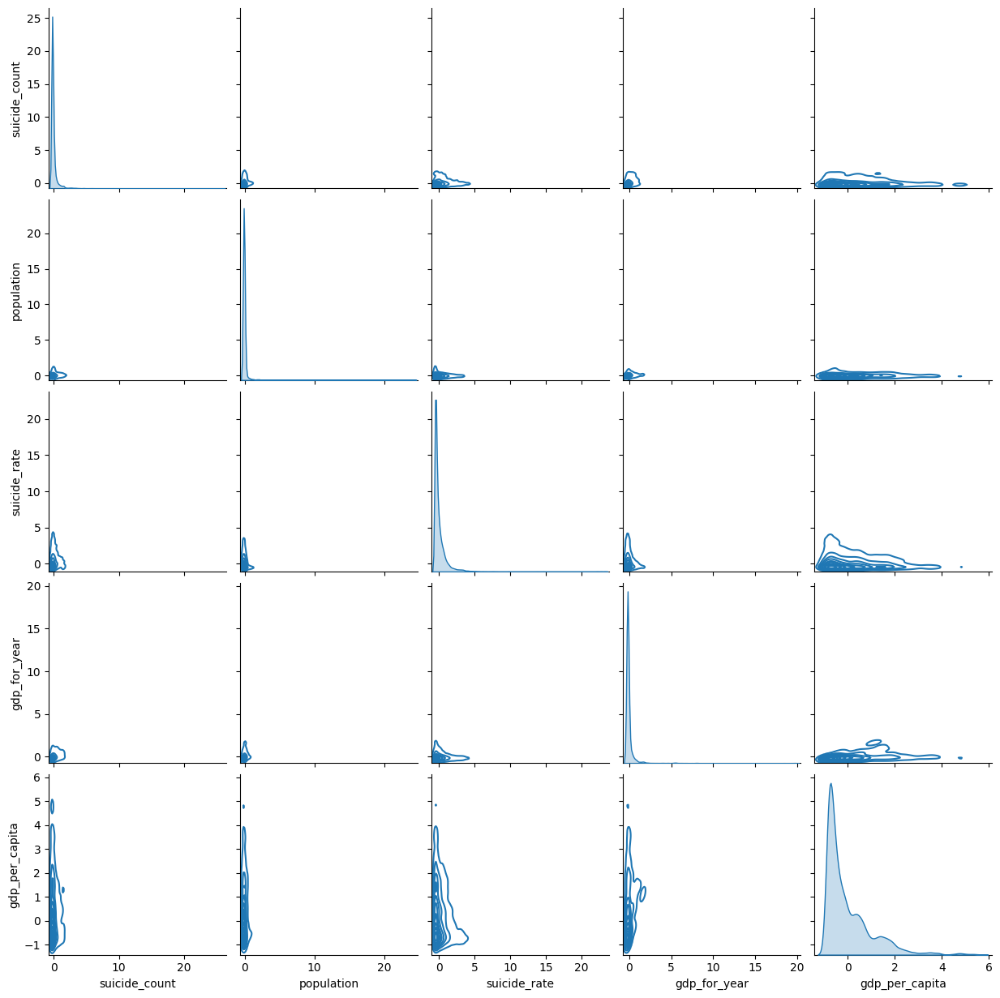

In [38]:
sns.pairplot(scaled_numeric_data,kind="kde")

##### In this part of coding in have used another library with plotly called cufflink to show outliers

In [39]:
# visualizing data using plotly and cufflink
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

print(__version__) # requires version >= 1.9.0
import cufflinks as cf
# For Notebooks
init_notebook_mode(connected=True)
# For offline use
cf.go_offline()

5.11.0


In [40]:
scaled_numeric_data.iplot(kind="box",boxpoints='outliers')

##### to remove the outlier we have used z_scores method. as we see in the below boxplot , the method we unable to move all the outliers because our data was highly skewed on left side 

In [41]:
#handling outliers
from scipy import stats
z_scores = stats.zscore(scaled_numeric_data)
threshold = 3
scaled_numeric_data = scaled_numeric_data[(abs(z_scores) < threshold).all(axis=1)]

In [42]:
scaled_numeric_data.iplot(kind="box",boxpoints='outliers')

##### here we have merging both categorical and numeric data together  and check for null value for the final time so that we can passed the data to the model

In [43]:
#merging categorical and scaled_numeric_data together for finaldata set
final_data = pd.concat([categorical_data,scaled_numeric_data],axis=1)

In [44]:
final_data.dropna(axis=0,inplace=True)
px.bar(final_data.isnull().sum())

## spliting data using  train_test_split

In [45]:
from sklearn.model_selection import train_test_split

In [46]:
y = final_data["suicide_rate"]
X = final_data.drop("suicide_rate",axis=1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

#####  in this part of code we have passed our data to three different model KNN, linear and randomforest regression.
#### note:- all the model as type of regression as our target class was in contious form

## KNN Regressor

In [47]:
from sklearn.neighbors import KNeighborsRegressor

In [48]:
knn = KNeighborsRegressor(n_neighbors=2)
knn.fit(X_train,y_train)


KNeighborsRegressor(n_neighbors=2)

In [49]:
prediction = knn.predict(X_test)

In [50]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

In [51]:
knn_mse = mean_squared_error(y_test, prediction)
knn_mae = mean_absolute_error(y_test, prediction)
knn_r2 = r2_score(y_test, prediction)
knn_score = knn.score(X_test,y_test)

print(knn.score(X_test,y_test))
print("MSE: {:.2f}".format(knn_mse))
print("MAE: {:.2f}".format(knn_mae))
print("R-squared: {:.2f}".format(knn_r2))

0.697796156029929
MSE: 0.12
MAE: 0.16
R-squared: 0.70


In [52]:
error_rate = []

for i in range(1,40):
    
    knn = KNeighborsRegressor(n_neighbors=i)
    knn.fit(X_train,y_train)
    predictions_i = knn.predict(X_test)
    error_rate.append(np.mean(predictions_i != y_test))
    

Text(0, 0.5, 'error rate')

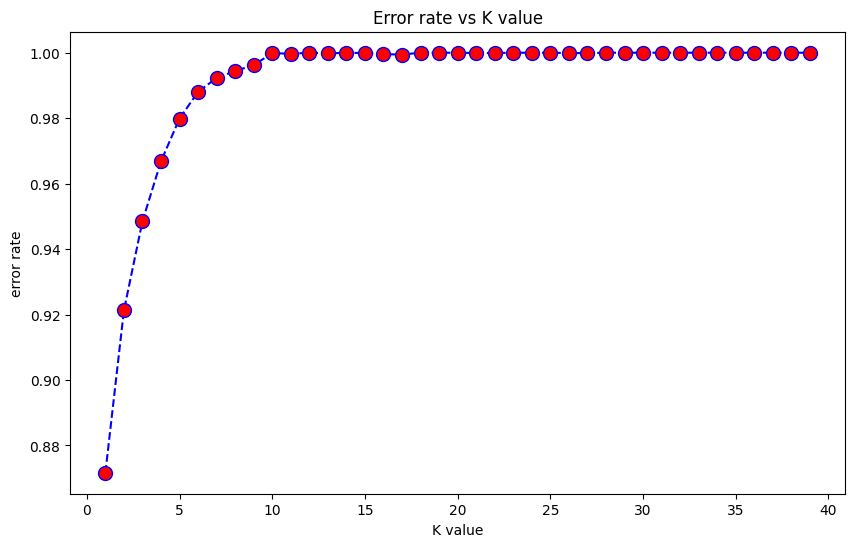

In [53]:
plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color="blue",ls="dashed",marker='o',
         markerfacecolor='red',markersize=10)
plt.title("Error rate vs K value")
plt.xlabel("K value")
plt.ylabel("error rate")

##  linearRegression

In [54]:
from sklearn.linear_model import LinearRegression

In [55]:
lr = LinearRegression()

In [56]:
lr.fit(X_train,y_train)


LinearRegression()

In [57]:
lr_predictions = lr.predict(X_test)

In [58]:
lr_mse = mean_squared_error(y_test, lr_predictions)
lr_mae = mean_absolute_error(y_test, lr_predictions)
lr_r2 = r2_score(y_test, lr_predictions)
lr_score = lr.score(X_test,y_test)


print(lr.score(X_test,y_test))
print("MSE: {:.2f}".format(lr_mse))
print("MAE: {:.2f}".format(lr_mae))
print("R-squared: {:.2f}".format(lr_r2))

0.34870955562261985
MSE: 0.25
MAE: 0.34
R-squared: 0.35


## RandomForestRegressor

In [60]:
from sklearn.ensemble import RandomForestRegressor

In [61]:
error_rate = []

for i in range(1,40):
    
    rfr = RandomForestRegressor(max_depth=i)
    rfr.fit(X_train,y_train)
    predictions_i = rfr.predict(X_test)
    error_rate.append(np.mean(predictions_i != y_test))
    

Text(0, 0.5, 'error rate')

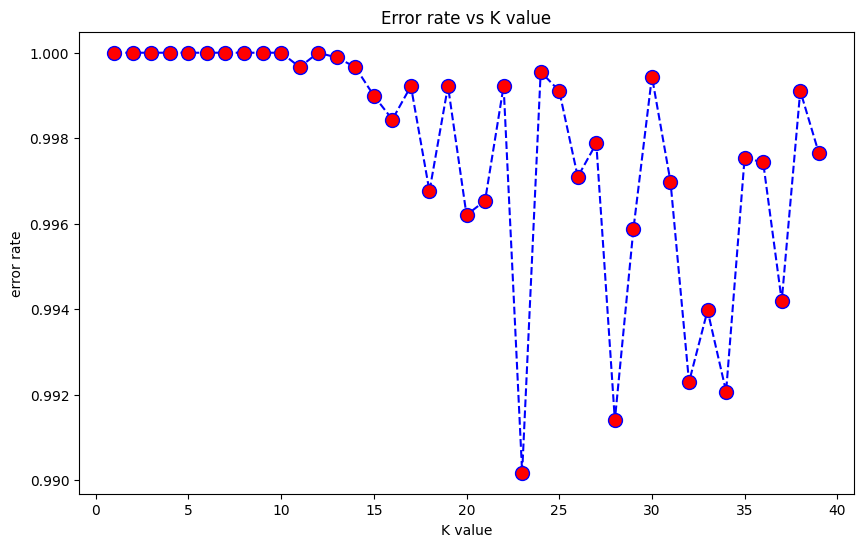

In [62]:
plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color="blue",ls="dashed",marker='o',
         markerfacecolor='red',markersize=10)
plt.title("Error rate vs K value")
plt.xlabel("K value")
plt.ylabel("error rate")

In [63]:
rfr = RandomForestRegressor(max_depth=29)
rfr.fit(X_train,y_train)
rfr_predictions = rfr.predict(X_test)

In [64]:
rfr_mse = mean_squared_error(y_test, rfr_predictions)
rfr_mae = mean_absolute_error(y_test, rfr_predictions)
rfr_r2 = r2_score(y_test, rfr_predictions)
rfr_score = rfr.score(X_test,y_test)


print(rfr.score(X_test,y_test))
print("MSE: {:.2f}".format(rfr_mse))
print("MAE: {:.2f}".format(rfr_mae))
print("R-squared: {:.2f}".format(rfr_r2))

0.9968130603993052
MSE: 0.00
MAE: 0.01
R-squared: 1.00


##### here we have created small data frame which campare the result of all three model. as we can see RandoForest method is performing extremly well. whereas linearRegression is the least suited model for this dataset. on the otherhand, KNN show moderate performance

In [65]:
model_result_data_array = {
    "KNeighborsRegressor": [knn_score,knn_mse,knn_mae, knn_r2],
    "LinearRegression": [lr_score,lr_mse,lr_mae, lr_r2],
    "RandomForestRegressor": [rfr_score,rfr_mse,rfr_mae, rfr_r2]
}

model_result_data = pd.DataFrame(model_result_data_array, index=["Score", "MSE", "MAE", "R-squared"])

model_result_data

,KNeighborsRegressor,LinearRegression,RandomForestRegressor
Score,0.697796,0.348710,0.996813
MSE,0.115128,0.248117,0.001214
MAE,0.155244,0.343592,0.009454
R-squared,0.697796,0.348710,0.996813


### as we have used the three different model and observe that RandomForestRegreesor is best suitable for this dataset whereas linear regression is worst for this model